In [1]:
# Audio matching (Audio Fingerprinting Test Case)
import os
from moviepy.editor import *
import pandas as pd
import IPython.display as ipd

import librosa
import numpy as np
import scipy.signal as signal
from scipy.signal import lfilter
import soundfile as sf
import matplotlib.pyplot as plt

In [45]:
# Extract the audio of the video of interest
clip_file = os.path.join('..', 'Data', 'Red Bull Dance Your Style 2022', 'Sara', 'Sara_clip.mp4')
video_clip = VideoFileClip(clip_file)
audio = video_clip.audio

audio_file = os.path.join('..', 'Data', 'Red Bull Dance Your Style 2022', 'Sara', 'Sara_clip.mp3')
audio.write_audiofile(audio_file)

video_clip.close()
audio.close()

MoviePy - Writing audio in ..\Data\Red Bull Dance Your Style 2022\Sara\Sara_clip.mp3


MoviePy - Done.


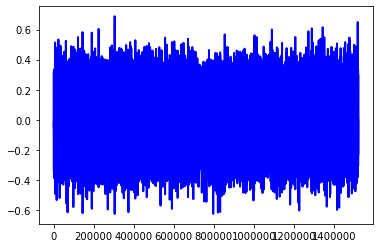

In [58]:
x, Fs = librosa.load(audio_file)

if len(x.shape) == 2:
    x = librosa.to_mono(x)

# t = range(0, 1/Fs, len(x)/Fs)
plt.plot(x, linewidth=2, linestyle='-', c='b')
ipd.display(ipd.Audio(data=x, rate=Fs))

In [55]:
print(len(x)/Fs)

69.04


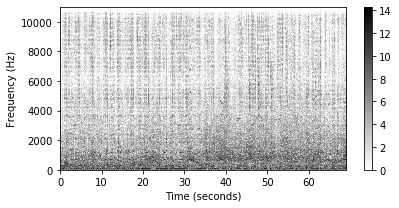

In [47]:
# Apply Spectral Gating
# Compute the STFT of the audio
N = 4096
H = 512
color = 'gray_r'

X = librosa.stft(x, pad_mode='constant', center=True)
Y = np.log(1 + 100*np.abs(X)**2)

T_coef = np.arange(X.shape[1]) * H / Fs

K = N // 2
F_coef = np.arange(K+1) * Fs / N

plt.figure(figsize=(6, 3))
extent = [T_coef[0], T_coef[-1], F_coef[0], F_coef[-1]]
plt.imshow(Y, cmap=color, aspect='auto', origin='lower', extent=extent)
plt.xlabel('Time (seconds)')
plt.ylabel('Frequency (Hz)')
plt.colorbar()
plt.tight_layout()
plt.show()

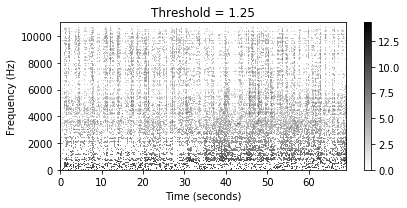

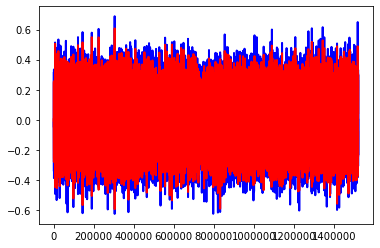

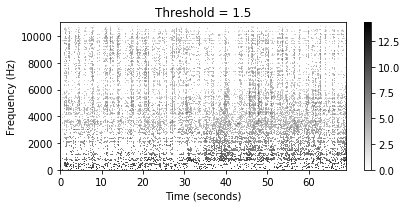

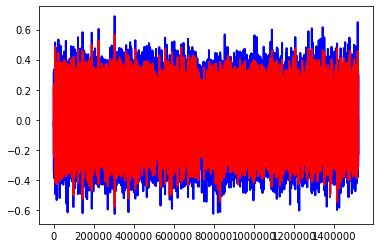

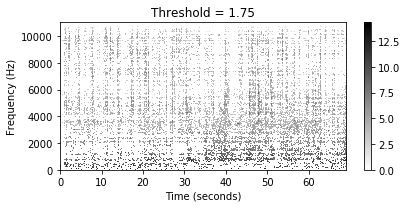

...

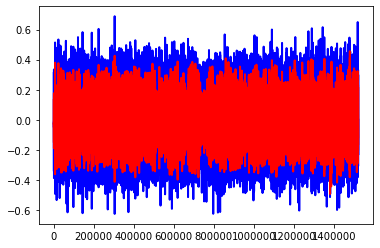

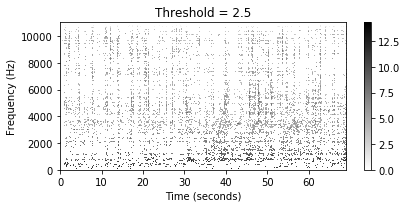

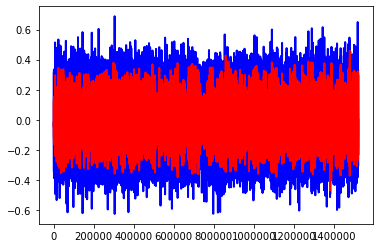

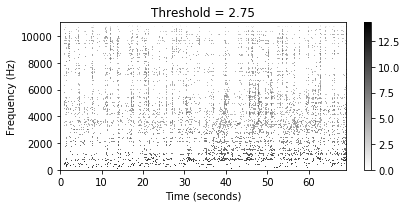

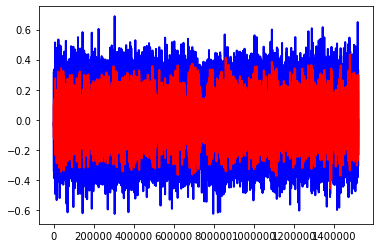

In [61]:
# Identify a segment with only noise (e.g., first 0.5 seconds)
noise_segment = x[:int(0.5 * Fs)]

# Compute the noise power spectral density
X_noise = librosa.stft(noise_segment, pad_mode='constant', center=True)
noise_spectral_density = np.mean(np.abs(X_noise)**2, axis=1)

# Compute the magnitude of the STFT
X_mag = np.abs(X)
X_phase = np.angle(X)

# Compute the spectral gate threshold
w_threshold = [1.25, 1.5, 1.75, 2.0, 2.25, 2.5, 2.75]
thresholds = []
for w in w_threshold:
    threshold = np.sqrt(noise_spectral_density)*w

    # Apply the threshold
    X_mag_denoised = np.where(X_mag < threshold[:, None], 0, X_mag)

    # Reconstruct the audio from the denoised magnitude and original phase
    stft_denoised = X_mag_denoised*np.exp(1j*X_phase)
    Y_denoised = np.log(1 + 100*np.abs(stft_denoised)**2)

    T_coef = np.arange(stft_denoised.shape[1]) * H / Fs

    K = N // 2
    F_coef = np.arange(K+1) * Fs / N

    plt.figure(figsize=(6, 3))
    extent = [T_coef[0], T_coef[-1], F_coef[0], F_coef[-1]]
    plt.imshow(Y_denoised, cmap=color, aspect='auto', origin='lower', extent=extent)
    plt.xlabel('Time (seconds)')
    plt.ylabel('Frequency (Hz)')
    plt.title('Threshold = {}'.format(w))
    plt.colorbar()
    plt.tight_layout()
    plt.show()

    x_denoised = librosa.istft(stft_denoised)
    plt.plot(x, linewidth=2, linestyle='-', c='b')
    plt.plot(x_denoised, linewidth=2, linestyle='-', c='r')
    ipd.display(ipd.Audio(data=x_denoised, rate=Fs))


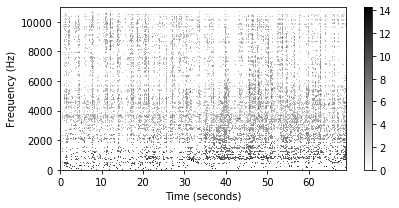

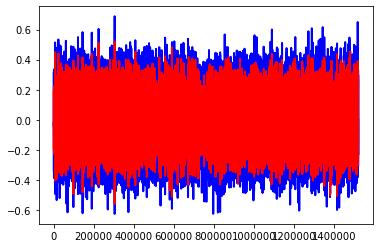

In [63]:
from scipy.signal import stft, istft
from scipy.ndimage import median_filter

# Adaptive Spectral Gating
# Identify a segment with only noise (e.g., first 0.5 seconds)
noise_segment = x[:int(0.5 * Fs)]

# Compute the noise power spectral density
Zxx_noise = librosa.stft(noise_segment, pad_mode='constant', center=True)

# Calculate the median and standard deviation of the noise power spectrum
noise_median = np.median(np.abs(Zxx_noise), axis=1)
noise_std = np.std(np.abs(Zxx_noise), axis=1)

# Step 4: Apply Adaptive Spectral Gating
# Compute STFT of the entire audio
Zxx = librosa.stft(x, pad_mode='constant', center=True)

# Create a dynamic mask based on the noise profile statistics
threshold_factor = 2.0  # Adjust this factor based on the noise level
adaptive_threshold = noise_median + threshold_factor * noise_std
adaptive_threshold = median_filter(adaptive_threshold, size=3)  # Smooth the threshold

# Apply the adaptive threshold to the STFT
mask = np.abs(Zxx) > adaptive_threshold[:, None]
Zxx_denoised = Zxx * mask
Zyy_denoised = np.log(1 + 100*np.abs(Zxx_denoised)**2)

T_coef = np.arange(Zxx_denoised.shape[1]) * H / Fs

K = N // 2
F_coef = np.arange(K+1) * Fs / N

plt.figure(figsize=(6, 3))
extent = [T_coef[0], T_coef[-1], F_coef[0], F_coef[-1]]
plt.imshow(Zyy_denoised, cmap=color, aspect='auto', origin='lower', extent=extent)
plt.xlabel('Time (seconds)')
plt.ylabel('Frequency (Hz)')
plt.colorbar()
plt.tight_layout()
plt.show()

# Compute the inverse STFT to get the cleaned audio
cleaned_audio = librosa.istft(Zxx_denoised)
plt.plot(x, linewidth=2, linestyle='-', c='b')
plt.plot(cleaned_audio, linewidth=2, linestyle='-', c='r')
ipd.display(ipd.Audio(data=cleaned_audio, rate=Fs))

In [32]:
def stft_convention_fmp(x, Fs, N, H, pad_mode='constant', center=True, mag=False, gamma=0):
    """Compute the discrete short-time Fourier transform (STFT)

    Args:
        x (np.ndarray): Signal to be transformed
        Fs (scalar): Sampling rate
        N (int): Window size
        H (int): Hopsize
        pad_mode (str): Padding strategy is used in librosa (Default value = 'constant')
        center (bool): Centric view as used in librosa (Default value = True)
        mag (bool): Computes magnitude STFT if mag==True (Default value = False)
        gamma (float): Constant for logarithmic compression (only applied when mag==True) (Default value = 0)

    Returns:
        X (np.ndarray): Discrete (magnitude) short-time Fourier transform
    """
    X = librosa.stft(x, n_fft=N, hop_length=H, win_length=N,
                     window='hann', pad_mode=pad_mode, center=center)
    if mag:
        X = np.abs(X)**2
        if gamma > 0:
            X = np.log(1 + gamma * X)
    F_coef = librosa.fft_frequencies(sr=Fs, n_fft=N)
    T_coef = librosa.frames_to_time(np.arange(X.shape[1]), sr=Fs, hop_length=H)
    # T_coef = np.arange(X.shape[1]) * H/Fs
    # F_coef = np.arange(N//2+1) * Fs/N
    return X, T_coef, F_coef

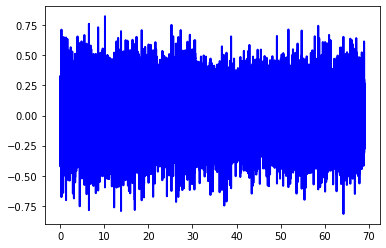

In [64]:
# Noise Reduction
from scipy.signal import lfilter
from matplotlib import pyplot as plt

n = 15  # the larger n is, the smoother curve will be
b = [1.0 / n] * n
a = 1
yy = lfilter(b, a, y)
plt.plot(x, yy, linewidth=2, linestyle='-', c='b')  # smooth by filter

In [11]:
# Normalize function
def normalize_feature(X, norm='2', threshold=0.0001, v=None):
    """Normalizes the columns of a feature sequence

    Args:
        X (np.ndarray): Feature sequence
        norm (str): The norm to be applied. '1', '2', 'max' or 'z' (Default value = '2')
        threshold (float): An threshold below which the vector ``v`` used instead of normalization
            (Default value = 0.0001)
        v (float): Used instead of normalization below ``threshold``. If None, uses unit vector for given norm
            (Default value = None)

    Returns:
        X_norm (np.ndarray): Normalized feature sequence
    """
    assert norm in ['1', '2', 'max', 'z']

    K, N = X.shape
    X_norm = np.zeros((K, N))

    if norm == '1':
        if v is None:
            v = np.ones(K, dtype=np.float64) / K
        for n in range(N):
            s = np.sum(np.abs(X[:, n]))
            if s > threshold:
                X_norm[:, n] = X[:, n] / s
            else:
                X_norm[:, n] = v

    if norm == '2':
        if v is None:
            v = np.ones(K, dtype=np.float64) / np.sqrt(K)
        for n in range(N):
            s = np.sqrt(np.sum(X[:, n] ** 2))
            if s > threshold:
                X_norm[:, n] = X[:, n] / s
            else:
                X_norm[:, n] = v

    if norm == 'max':
        if v is None:
            v = np.ones(K, dtype=np.float64)
        for n in range(N):
            s = np.max(np.abs(X[:, n]))
            if s > threshold:
                X_norm[:, n] = X[:, n] / s
            else:
                X_norm[:, n] = v

    if norm == 'z':
        if v is None:
            v = np.zeros(K, dtype=np.float64)
        for n in range(N):
            mu = np.sum(X[:, n]) / K
            sigma = np.sqrt(np.sum((X[:, n] - mu) ** 2) / (K - 1))
            if sigma > threshold:
                X_norm[:, n] = (X[:, n] - mu) / sigma
            else:
                X_norm[:, n] = v

    return X_norm